In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import shutil
import numpy as np
import pandas as pd
from pathlib import Path

np.random.seed(42)

## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 200

## Download and Prepare the Dataset


In [ ]:

#____________________________________________________________
from google.colab import drive
drive.mount('/content/drive')

!ls "/content/drive/My Drive"
#!ls "/content/drive/My Drive/crop"
#!ls "/content/drive/My Drive/images"

#____________________________________________________________
from warnings import filterwarnings
filterwarnings("ignore")

directory = '/content/drive/My Drive/'
# convert str to Path
#directory = Path(directory)

Mounted at /content/drive
'Colab Notebooks'			      f16.jpg	    yolov5m_med.pt
 crop					      f16_vid.mp4   yolov5s_low.pt
 Custom_Object_Detection_using_YOLOv5.ipynb   yolov5


In [ ]:
directory = '/content/drive/MyDrive/'

In [ ]:
directory

'/content/drive/MyDrive/'

In [ ]:
# collect class names
class_names = sorted(os.listdir(directory + '/crop'))
# create class2id map
class2id = {class_name: i for i, class_name in enumerate(class_names)}
class2id

{'A10': 0,
 'A400M': 1,
 'AG600': 2,
 'AV8B': 3,
 'B1': 4,
 'B2': 5,
 'B52': 6,
 'Be200': 7,
 'C130': 8,
 'C17': 9,
 'C2': 10,
 'C5': 11,
 'E2': 12,
 'E7': 13,
 'EF2000': 14,
 'F117': 15,
 'F14': 16,
 'F15': 17,
 'F16': 18,
 'F18': 19,
 'F22': 20,
 'F35': 21,
 'F4': 22,
 'J20': 23,
 'JAS39': 24,
 'MQ9': 25,
 'Mig31': 26,
 'Mirage2000': 27,
 'P3': 28,
 'RQ4': 29,
 'Rafale': 30,
 'SR71': 31,
 'Su34': 32,
 'Su57': 33,
 'Tornado': 34,
 'Tu160': 35,
 'Tu95': 36,
 'U2': 37,
 'US2': 38,
 'V22': 39,
 'Vulcan': 40,
 'XB70': 41,
 'YF23': 42}

In [ ]:
classes = np.array(['A10','A400M','AG600','AV8B','Vulcan',
                    'B1','B2','B52','Be200','C130','YF23',
                    'C2','C17','C5','E2','E7','EF2000',
                    'F117','F14','F15','F16','F18','F22',
                    'F35','F4','JAS39','MQ9','Mig31','U2',
                    'Mirage2000','P3','RQ4','Rafale',
                    'SR71','Su34','Su57','Tu160','Tu95',
                    'Tornado','US2', 'V22','XB70','J20'])

In [ ]:
classes.sort()
classes

array(['A10', 'A400M', 'AG600', 'AV8B', 'B1', 'B2', 'B52', 'Be200',
       'C130', 'C17', 'C2', 'C5', 'E2', 'E7', 'EF2000', 'F117', 'F14',
       'F15', 'F16', 'F18', 'F22', 'F35', 'F4', 'J20', 'JAS39', 'MQ9',
       'Mig31', 'Mirage2000', 'P3', 'RQ4', 'Rafale', 'SR71', 'Su34',
       'Su57', 'Tornado', 'Tu160', 'Tu95', 'U2', 'US2', 'V22', 'Vulcan',
       'XB70', 'YF23'], dtype='<U10')

The original data had two instances of each image and label file. The rest of the code in the above block deletes the duplicate image and it's corresponding text file containing the label.

The dataset is structured in the following manner:

```
├── data.yaml
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

In [ ]:
ls

drive/  sample_data/


In [ ]:
csv_paths = glob.glob(directory + '/dataset/*.csv')
jpg_paths = glob.glob(directory + '/dataset/*.jpg')
csv_paths.sort()
jpg_paths.sort()
print('number of images:',len(csv_paths))


os.makedirs(directory + '/yolov5/data/train/images', exist_ok=True)
os.makedirs(directory + '/yolov5/data/train/labels', exist_ok=True)

os.makedirs(directory + '/yolov5/data/valid/images', exist_ok=True)
os.makedirs(directory + '/yolov5/data/valid/labels', exist_ok=True)

os.makedirs(directory + '/yolov5/data/test/images', exist_ok=True)
os.makedirs(directory + '/yolov5/data/test/labels', exist_ok=True)

number of images: 0


In [ ]:
def convert_pascal_voc_format_to_yolo_format(annotation: np.array):
  width = annotation[1]
  height = annotation[2]
  class_name = annotation[3]
  xmin = annotation[4]
  ymin = annotation[5]
  xmax = annotation[6]
  ymax = annotation[7]
  x_center = (xmin+xmax)/2.0
  y_center = (ymin+ymax)/2.0
  bbox_width = xmax - xmin
  bbox_height= ymax - ymin
  class_num = class2id[class_name]
  output_string = '{} {} {} {} {}\n'.format(class_num,
                                            x_center/width,
                                            y_center/height,
                                            bbox_width/width,
                                            bbox_height/height)
  return output_string

In [ ]:
#now lets find files that doesn`t have pair '.jpg' or '.csv'
def find_files_that_do_not_have_pair(files : list):

  jpg_files = set()
  csv_files = set()

  # separate the jpg and csv files into two sets
  for file in files:
      if file.endswith('.jpg'):
          jpg_files.add(file[:-4])
      elif file.endswith('.csv'):
          csv_files.add(file[:-4])

  # find the files that don't have a pair
  unpaired_files = []
  for file in jpg_files:
      if file not in csv_files:
          unpaired_files.append(file)

  for file in csv_files:
      if file not in jpg_files:
          unpaired_files.append(file)

  if len(unpaired_files) == 0:
      print("No unpaired files found.")
  else:
      for file in unpaired_files:
          print(f"The file '{file}.jpg' or '{file}.csv' does not have a pair.")
  return unpaired_files

In [ ]:
def find_files_that_do_not_have_pair(jpg : list, txt : list):

  jpg_files = set()
  csv_files = set()

  # separate the jpg and csv files into two sets
  for file in jpg:
      if file.endswith('.jpg'):
          jpg_files.add(file[:-4])
      elif file.endswith('.txt'):
          csv_files.add(file[:-4])

  for file in txt:
      if file.endswith('.jpg'):
          jpg_files.add(file[:-4])
      elif file.endswith('.txt'):
          csv_files.add(file[:-4])

  # find the files that don't have a pair
  unpaired_files = []
  for file in jpg_files:
      if file not in csv_files:
          unpaired_files.append(file)

  for file in csv_files:
      if file not in jpg_files:
          unpaired_files.append(file)

  if len(unpaired_files) == 0:
      print("No unpaired files found.")
  else:
      for file in unpaired_files:
          print(f"The file '{file}.jpg' or '{file}.csv' does not have a pair.")
  return unpaired_files

In [ ]:
find_files_that_do_not_have_pair(os.listdir(directory + 'dataset'))

The file '459f7bf35de2135da6c08070eab4d1ef.jpg' or '459f7bf35de2135da6c08070eab4d1ef.csv' does not have a pair.
The file '459f7bf35de2135da6c08070eab4d1ef (1).jpg' or '459f7bf35de2135da6c08070eab4d1ef (1).csv' does not have a pair.


['459f7bf35de2135da6c08070eab4d1ef', '459f7bf35de2135da6c08070eab4d1ef (1)']

In [ ]:
# split to train and validation datasets

TEST_DATA_PERCENTAGE = 0.8
files = os.listdir(directory + 'dataset')
num_files = len(files)
sorted_files = sorted(files)

num_train_dataset_files = int(num_files * TEST_DATA_PERCENTAGE)

train_dataset_files = sorted_files[:num_train_dataset_files]
validation_dataset_files = sorted_files[num_train_dataset_files:]


FileNotFoundError: ignored

In [ ]:
len(validation_dataset_files)

NameError: ignored

In [ ]:
len(train_dataset_files)

17420

In [ ]:
lost_val_files = find_files_that_do_not_have_pair(validation_dataset_files)
len(lost_val_files)

No unpaired files found.


0

In [ ]:
lost_train_files = find_files_that_do_not_have_pair(train_dataset_files)
len(lost_train_files)

The file '459f7bf35de2135da6c08070eab4d1ef.jpg' or '459f7bf35de2135da6c08070eab4d1ef.csv' does not have a pair.
The file '459f7bf35de2135da6c08070eab4d1ef (1).jpg' or '459f7bf35de2135da6c08070eab4d1ef (1).csv' does not have a pair.


2

In [ ]:
# txt_file_path = directory + 'yolov5/data/train/labels/' + train_dataset_files[0][:-4] + '.txt'
# jpg_file_path = directory + 'yolov5/data/train/images/' + train_dataset_files[0+1]
# print(txt_file_path)
# print(jpg_file_path)
# shutil.move(directory + 'dataset/' + train_dataset_files[0+1], jpg_file_path)


/content/drive/My Drive/yolov5/data/train/labels/000106393cfe2343888c584e65fd2274.txt
/content/drive/My Drive/yolov5/data/train/images/000106393cfe2343888c584e65fd2274.jpg


'/content/drive/My Drive/yolov5/data/train/images/000106393cfe2343888c584e65fd2274.jpg'

In [ ]:
#shutil.move(jpg_file_path, directory + 'dataset/' + train_dataset_files[0+1])

'/content/drive/My Drive/dataset/000106393cfe2343888c584e65fd2274.jpg'

In [ ]:
# split to train and validation datasets
for i in range(0, len(train_dataset_files), 2):
    if i+1 < len(train_dataset_files) and train_dataset_files[i].startswith(train_dataset_files[i+1][:-4]):
      txt_file_path = directory + 'yolov5/data/train/labels/' + train_dataset_files[i][:-4] + '.txt'
      jpg_file_path = directory + 'yolov5/data/train/images/' + train_dataset_files[i+1]
      shutil.move(directory + 'dataset/' + train_dataset_files[i+1], jpg_file_path)

      annotations = np.array(pd.read_csv(directory + 'dataset/' + train_dataset_files[i]))
      with open(txt_file_path, mode='w') as f:
            try:
                for annotation in annotations:
                    yolo_annotation = convert_pascal_voc_format_to_yolo_format(annotation)
                    f.write(yolo_annotation)
            except:
                 print("ERROR")


for i in range(0, len(validation_dataset_files), 2):
    if i+1 < len(validation_dataset_files) and validation_dataset_files[i].startswith(validation_dataset_files[i+1][:-4]):
      txt_file_path = directory + 'yolov5/data/valid/labels/' + validation_dataset_files[i][:-4] + '.txt'
      jpg_file_path = directory + 'yolov5/data/valid/images/' + validation_dataset_files[i+1]
      shutil.move(directory + 'dataset/' + validation_dataset_files[i+1], jpg_file_path)

      annotations = np.array(pd.read_csv(directory + 'dataset/' + validation_dataset_files[i]))
      with open(txt_file_path, mode='w') as f:
            try:
                for annotation in annotations:
                    yolo_annotation = convert_pascal_voc_format_to_yolo_format(annotation)
                    f.write(yolo_annotation)
            except:
                print("ERROR")


print('valid:', len(glob.glob(directory + 'yolov5/data/valid/labels/*.txt')))
print('train', len(glob.glob(directory + 'yolov5/data/train/labels/*.txt')))

test: 0
valid: 2178
train 8710


### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 43 classes

The following block shows the contents of the `data.yaml` file.

In [ ]:
classes_string = ', '.join([f'"{c}"' for c in classes])
with open(directory + 'yolov5/data/data.yaml', mode='w') as f:
    yaml_string='train: ../drive/My Drive/yolov5/data/train\n'\
              + 'val: ../drive/My Drive/yolov5/data/valid\n'\
              + f'nc: {len(classes)}\n'\
              + f'names: [{classes_string}]'
    f.write(yaml_string)
print(yaml_string)

train: ../drive/My Drive/yolov5/data/train
val: ../drive/My Drive/yolov5/data/valid
nc: 43
names: ["A10", "A400M", "AG600", "AV8B", "B1", "B2", "B52", "Be200", "C130", "C17", "C2", "C5", "E2", "E7", "EF2000", "F117", "F14", "F15", "F16", "F18", "F22", "F35", "F4", "J20", "JAS39", "MQ9", "Mig31", "Mirage2000", "P3", "RQ4", "Rafale", "SR71", "Su34", "Su57", "Tornado", "Tu160", "Tu95", "U2", "US2", "V22", "Vulcan", "XB70", "YF23"]


### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images. 

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [ ]:
class_names = ['A10', 'A400M', 'AG600', 'AV8B', 'B1', 'B2', 'B52', 'Be200',
       'C130', 'C17', 'C2', 'C5', 'E2', 'E7', 'EF2000', 'F117', 'F14',
       'F15', 'F16', 'F18', 'F22', 'F35', 'F4', 'J20', 'JAS39', 'MQ9',
       'Mig31', 'Mirage2000', 'P3', 'RQ4', 'Rafale', 'SR71', 'Su34',
       'Su57', 'Tornado', 'Tu160', 'Tu95', 'U2', 'US2', 'V22', 'Vulcan',
       'XB70', 'YF23']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                #print(label_line)
                #label = label_line[0]
                label_l = label_line.split(' ')
                label = label_l[0]
                new_list = [x.strip() for x in label_l[1:]]
                bbox_string = new_list
                #print(bbox_string)
                #a = bbox_string.split(' ')
                #print(a)
                x_c, y_c, w, h = bbox_string
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

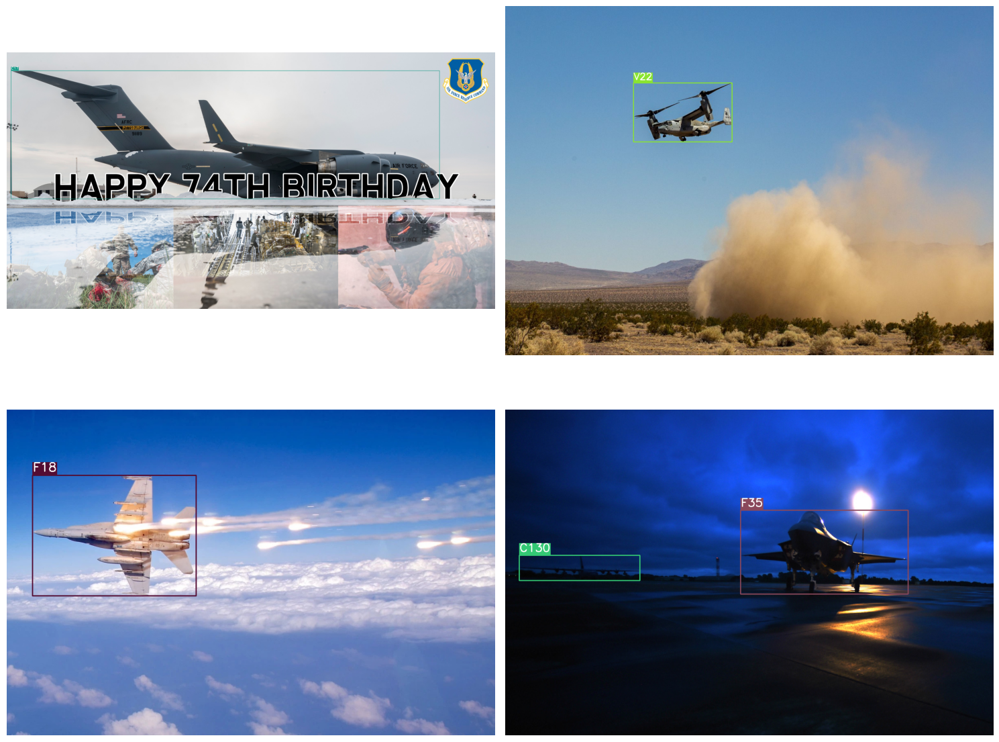

In [ ]:
# Visualize a few training images.
plot(
    image_paths= directory + 'yolov5/data/train/images/*', 
    label_paths= directory + 'yolov5/data/train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('/runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir /content/yolov5/runs/train

## Clone YOLOV5 Repository

In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 15679, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 15679 (delta 1), reused 2 (delta 0), pack-reused 15672
Receiving objects: 100% (15679/15679), 14.39 MiB | 22.46 MiB/s, done.
Resolving deltas: 100% (10747/10747), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 586.5/586.5 kB 34.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 205.1/205.1 kB 18.3 MB/s eta 0:00:00


## Training using YOLOV5

The next step is to train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [ ]:
ls


benchmarks.py    detect.py   __pycache__/      segment/        val.py
CITATION.cff     export.py   README.md         setup.cfg
classify/        hubconf.py  README.zh-CN.md   train.py
CONTRIBUTING.md  LICENSE     requirements.txt  tutorial.ipynb
data/            models/     runs/             utils/


In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../drive/MyDrive/yolov5/data/data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 0
results_1
Traceback (most recent call last):
  File "/content/yolov5/train.py", line 30, in <module>
    import torch
  File "/usr/local/lib/python3.10/dist-packages/torch/__init__.py", line 229, in <module>
    from torch._C import *  # noqa: F403
KeyboardInterrupt
^C


## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images and videos.

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    #!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    !python detect.py --weights ../drive/MyDrive/{RES_DIR} \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

In [ ]:
show_valid_results(RES_DIR)

ls: cannot access 'runs/train/results_1': No such file or directory
[]


### Inference
In this section, we will carry out inference on unseen images and videos from the internet. 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Let's download the images and videos that we will carry inference upon.

### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference("yolov5m_med.pt", '../drive/MyDrive/testingImg')

Current number of inference detection directories: 4
inference_5
detect: weights=['../drive/MyDrive/yolov5m_med.pt'], source=../drive/MyDrive/testingImg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /usr/local/lib/python3.10/dist-packages/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-168-gec2b853 Python-3.10.11 torch-2.0.1+cu118 CPU

Fusing layers... 
Model summary: 212 layers, 21010533 parameters, 0 gradients, 48.4 GFLOPs
image 1/4 /content/drive/MyDrive/testingImg/a10.jpg: 448x640 1 A10, 787.4ms
image 2/4 /content/drive/MyDrive/testingImg/f16.jpg: 448x640 4 F16s, 1115.6ms
image 3/4 /content/drive/MyDrive/test

['runs/detect/inference_5/a10.jpg', 'runs/detect/inference_5/su34.jpg', 'runs/detect/inference_5/tu95.jpg', 'runs/detect/inference_5/f16.jpg']


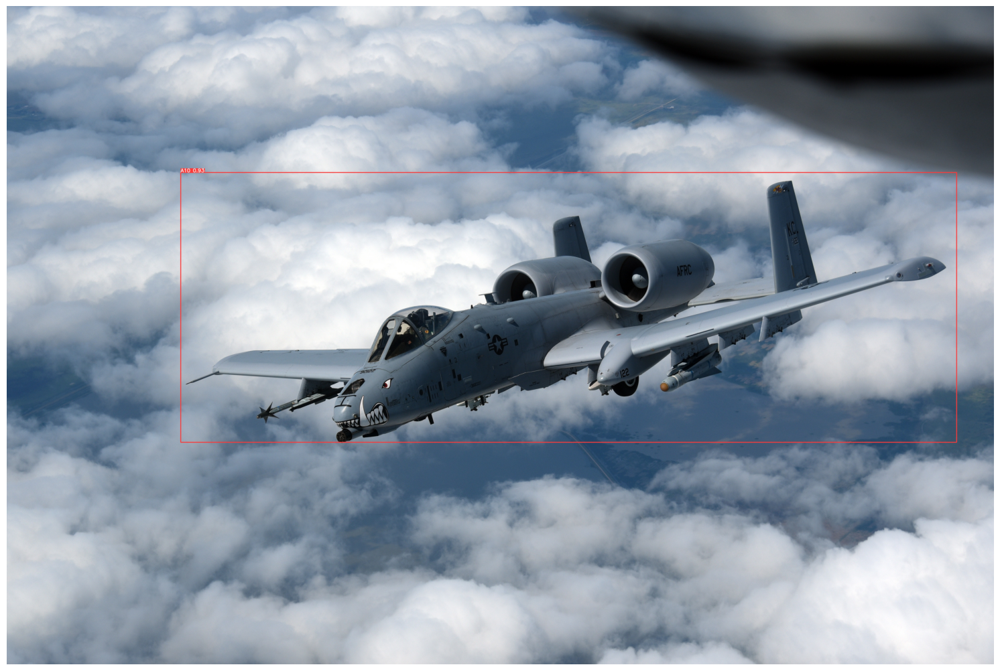

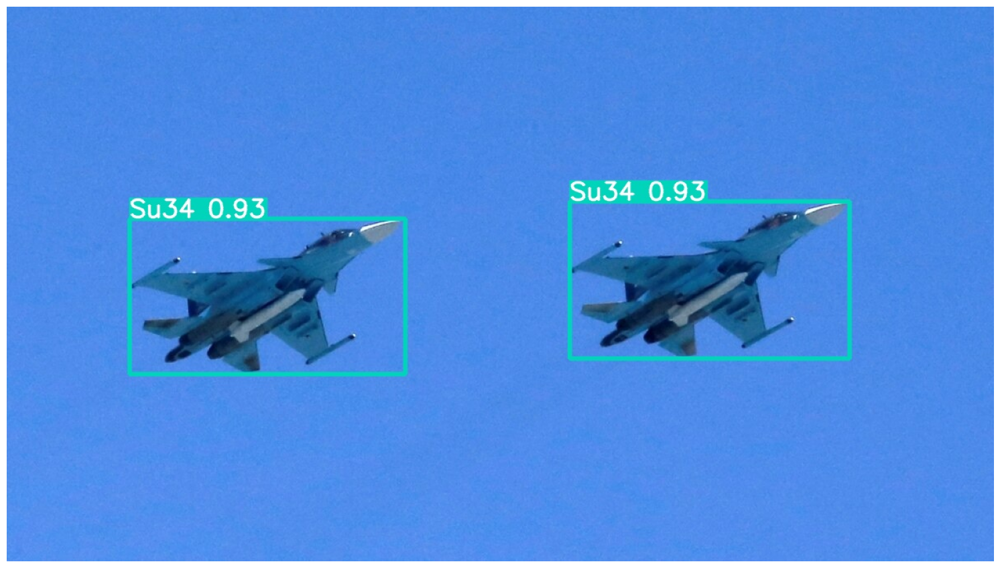

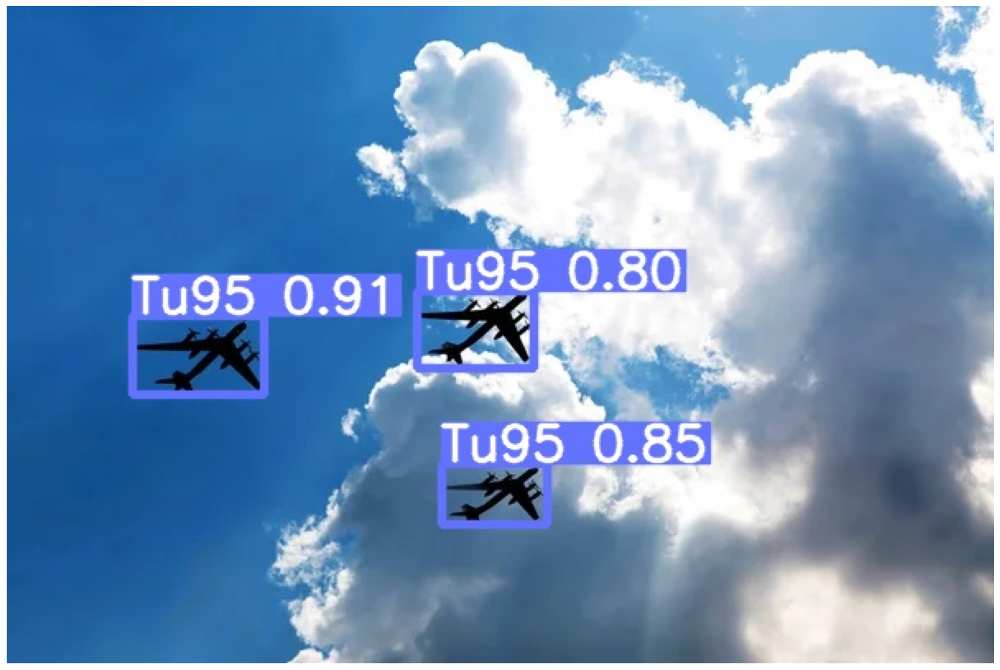

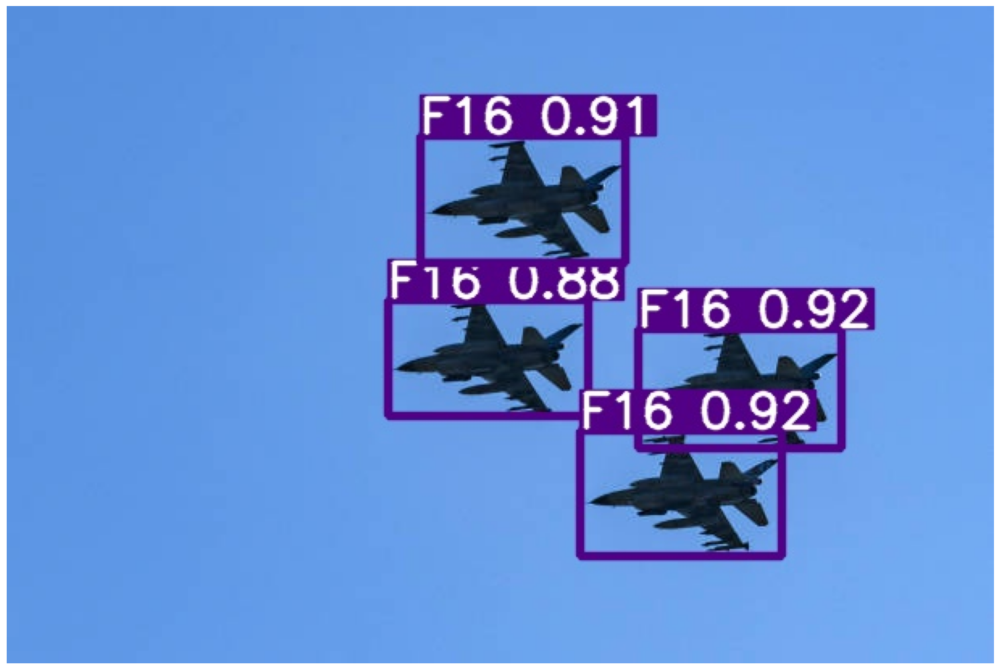

In [ ]:
visualize(IMAGE_INFER_DIR)

### Inference on Videos

In [ ]:
inference("yolov5m_med.pt", '../drive/MyDrive/USAircraft.mp4')

Показано результат, скорочений до останніх рядків (5000).
video 1/1 (1336/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 718.3ms
video 1/1 (1337/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 972.4ms
video 1/1 (1338/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 950.8ms
video 1/1 (1339/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 942.2ms
video 1/1 (1340/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 931.9ms
video 1/1 (1341/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 669.5ms
video 1/1 (1342/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 587.5ms
video 1/1 (1343/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 588.9ms
video 1/1 (1344/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 587.5ms
video 1/1 (1345/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 584.0ms
video 1/1 (1346/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 588.7ms
video 1

'inference_12'

In [ ]:
IMAGE_INFER_DIR = inference("yolov5s_low.pt", '../drive/MyDrive/testingImg')

Current number of inference detection directories: 9
inference_10
detect: weights=['../drive/MyDrive/yolov5s_low.pt'], source=../drive/MyDrive/testingImg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_10, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /usr/local/lib/python3.10/dist-packages/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-168-gec2b853 Python-3.10.11 torch-2.0.1+cu118 CPU

Fusing layers... 
Model summary: 157 layers, 7118005 parameters, 0 gradients, 16.1 GFLOPs
image 1/4 /content/drive/MyDrive/testingImg/a10.jpg: 448x640 1 A10, 303.2ms
image 2/4 /content/drive/MyDrive/testingImg/f16.jpg: 448x640 4 F16s, 272.3ms
image 3/4 /content/drive/MyDrive/test

['runs/detect/inference_10/a10.jpg', 'runs/detect/inference_10/su34.jpg', 'runs/detect/inference_10/tu95.jpg', 'runs/detect/inference_10/f16.jpg']


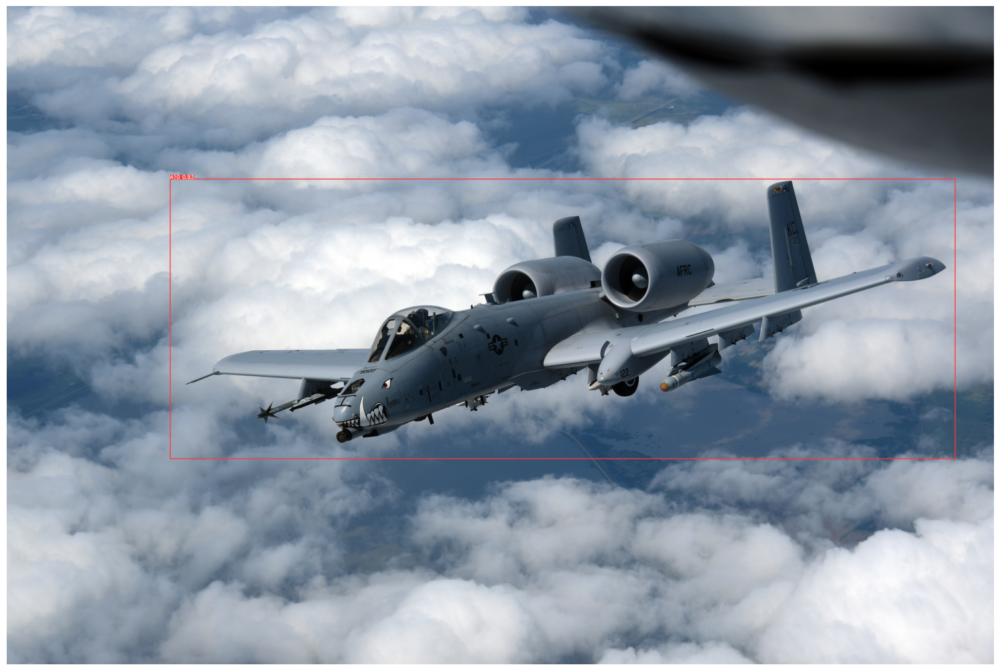

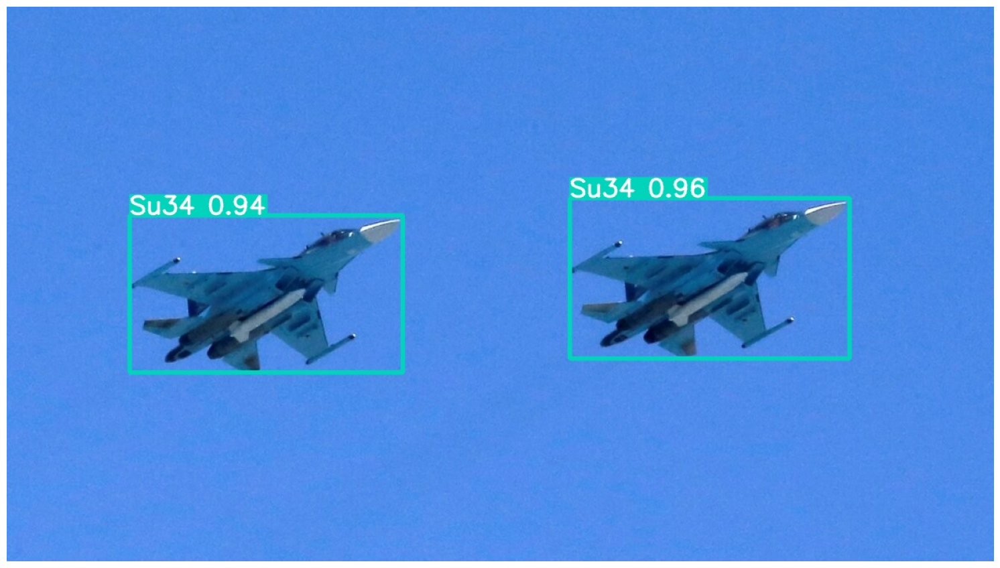

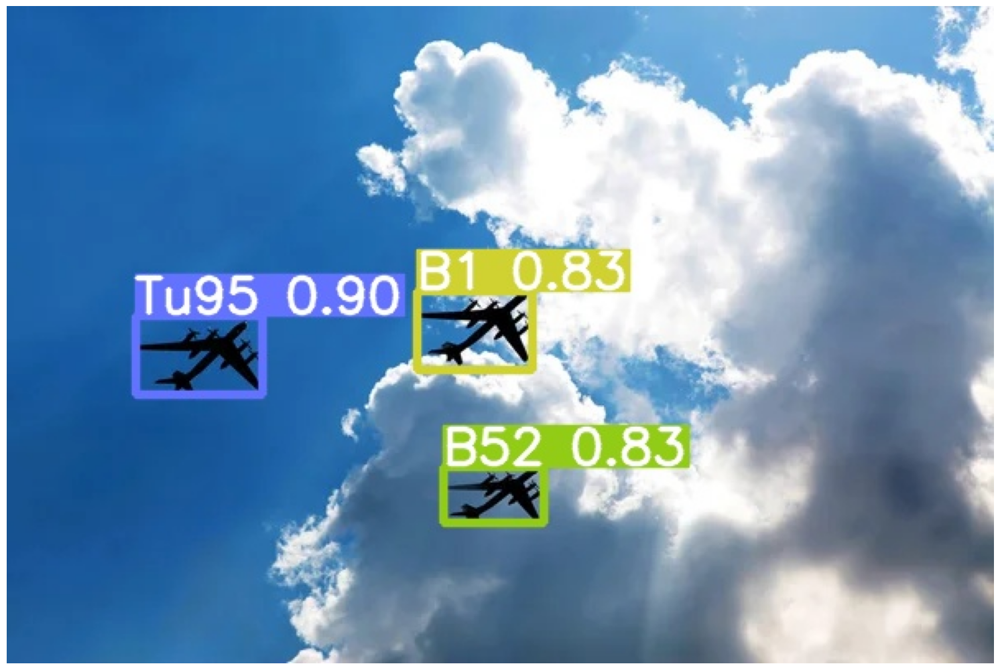

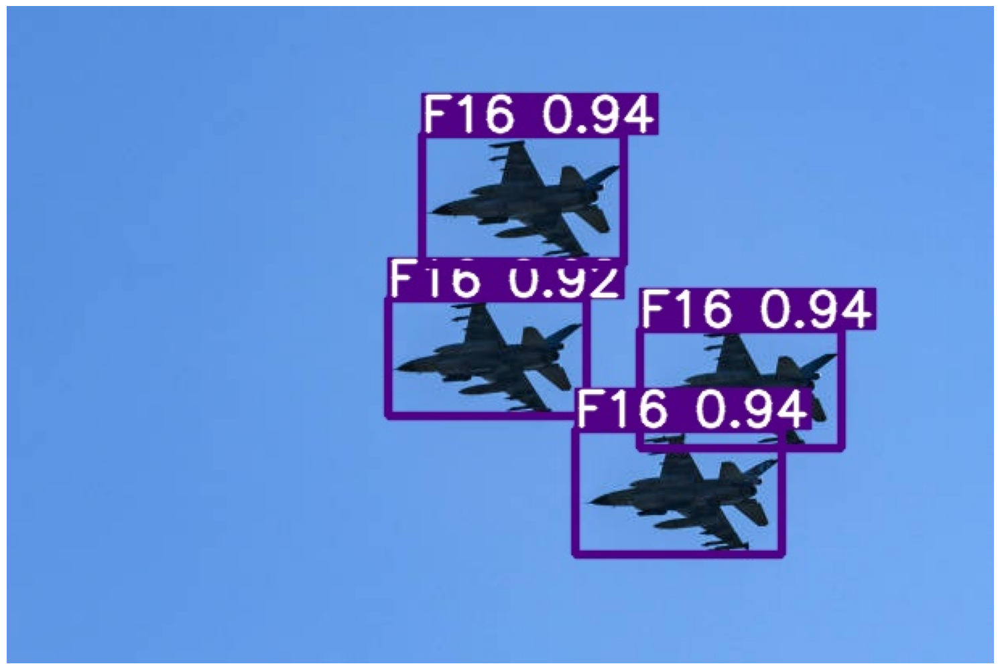

In [ ]:
visualize(IMAGE_INFER_DIR)

In [ ]:
inference("yolov5s_low.pt", '../drive/MyDrive/USAircraft.mp4')

Показано результат, скорочений до останніх рядків (5000).
video 1/1 (1336/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 272.7ms
video 1/1 (1337/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 380.7ms
video 1/1 (1338/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 363.8ms
video 1/1 (1339/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 1 F35, 372.5ms
video 1/1 (1340/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 1 F35, 357.5ms
video 1/1 (1341/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 1 F35, 371.4ms
video 1/1 (1342/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 2 F35s, 376.4ms
video 1/1 (1343/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F22, 2 F35s, 362.2ms
video 1/1 (1344/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 1 F35, 371.5ms
video 1/1 (1345/6333) /content/drive/MyDrive/USAircraft.mp4: 384x640 2 F18s, 

'inference_11'

## Training and Inference using  Medium Model

In [ ]:
monitor_tensorboard()

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.

In [ ]:
monitor_tensorboard()

In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 2
results_3
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_3, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0